# Disclaimer

This document was added after the deadline. Our team did not properly check the instruction from the wiki and all the time we thought that addition of code to the explanatory notebook is optional, not mandatory. Hence, I (Gustaw) decided to create this appendix to the Explanatory notebook.

Because this was created after the deadline, I will fully understand if this document will not be taken into consideration for the project evaluation. 

This documents consists of the code parts already present on the repository linked on the website. While making this document, I have not added any new comments/changed code/imporoved the results. I wanted to upload it to make it easier for the person verifying the code behind the report.

The jupyter notebook code, which was used for obtaining and filtering data, creating graphs and was used for NLP work comes from the jupyter notebooks. The code responsible for interactive visualisation comes from the python scripts from the *sgi-pokemon* repository. It used **plotly** and **dash** libraries, which without additional jupyter libraries, cannot be used within jupyter notebooks. Hence the code responsible for visualisation of interactive graphs can be found on the *sgi-pokemon* repository.

# Table of content

1. Code behind the Pokemon-episode graph (taken from *social-graphs-squad/pokemon/pokemon_episodes_graph.ipynb*)

2. Code behind the Pokemon-routes graph (taken from *social-graphs-squad/pokemon/location_graph2.ipynb*)

3. Code behind the Sentiment analysis 

    3.1. Code responsible for creating pokemon dataframe, words preprocessing (taken from *social-graphs-squad/pokemon/Pokemon-processing.ipynb*).
    
    3.2. Code responsible for NLP (taken from *social-graphs-squad/pokemon/Pokemon-Analysis-part-2.ipynb*)

# 1. Pokemon Episodes Graph

In [1]:
import re
import os
import itertools
import networkx as nx
import time
from IPython.display import clear_output
import numpy as np
import matplotlib.pyplot as plt

### Read Pokemon list file to get all Pokemon names

In [2]:
pokemon_list_file = "./pokemon list.txt"
all_pokemon_names = open(pokemon_list_file, encoding='utf-8').read().split("\n")[:-1] # last element is empty line

### Read episode files to get all the names and tags

In [3]:
episode_dir = "./episodes_files_raw/"
all_episodes = sorted(os.listdir("episodes_files_raw/"))
all_episodes_tags = [x[6:] for x in all_episodes]

### Generate a dictionary describing each Pokemon generation. Values are: name of the generation, episode range, Pokemon Pokedex number range, list of episode tags

In [4]:
generations = {
    1: {
        "name": "The Beginning", 
        "debut_ep": "EP001", 
        "final_ep": "EP116",
        "episodes": [],
        "first_pokemon": 1,
        "last_pokemon": 151,
        "pokemons": []
    },
    2: {
        "name": "Gold and Silver", 
        "debut_ep": "EP117", 
        "final_ep": "EP274",
        "episodes": [],
        "first_pokemon": 152,
        "last_pokemon": 251,
        "pokemons": []
    },
    3: {
        "name": "Ruby and Sapphire", 
        "debut_ep": "AG001", 
        "final_ep": "AG192",
        "episodes": [],
        "first_pokemon": 252,
        "last_pokemon": 386,
        "pokemons": []
    },
    4: {
        "name": "Diamond and Pearl", 
        "debut_ep": "DP001", 
        "final_ep": "DP191",
        "episodes": [],
        "first_pokemon": 387,
        "last_pokemon": 493,
        "pokemons": []
    },
    5: {
        "name": "Black & White", 
        "debut_ep": "BW001", 
        "final_ep": "BW142",
        "episodes": [],
        "first_pokemon": 494,
        "last_pokemon": 649,
        "pokemons": []
    },
    6: {
        "name": "XY", 
        "debut_ep": "XY001", 
        "final_ep": "XY140",
        "episodes": [],
        "first_pokemon": 650,
        "last_pokemon": 721,
        "pokemons": []
    },
    7: {
        "name": "Sund & Moon", 
        "debut_ep": "SM001", 
        "final_ep": "SM146",
        "episodes": [],
        "first_pokemon": 722,
        "last_pokemon": 809,
        "pokemons": []
    },
}

In [5]:
for key, value in generations.items():
    first_poke = value["first_pokemon"] - 1
    last_poke = value["last_pokemon"]    
    generations[key]["pokemons"] = all_pokemon_names[first_poke : last_poke]

    debut = value["debut_ep"]
    final = value["final_ep"]
    
    debut_idx = all_episodes_tags.index(debut)
    final_idx = all_episodes_tags.index(final)
    
    gen_episodes = all_episodes[debut_idx:final_idx+1]
    
    generations[key]["episodes"] = gen_episodes
    

## Create dictionary with Episode tags as keys and list of Pokemon in the Episode as value

In [6]:
def get_episodes_dict_with_pokemon(episode_names, ignore_pikachu = False):
    episodes_with_pokemon_list = {}

    for episode_tag in episode_names:
        episode_path = episode_dir + episode_tag
        episode_file = open(episode_path, encoding='utf-8').read()
        episode_pokemons_text = re.findall(r"(?<=Pokémon==)(.*)(?=Trivia)", episode_file)
        # following episodes: [0294]AG018;[0330]AG054;[0458]AG182;[0477]DP009;[0520]DP052
        # have different text formatting, hence an if workaround
        if len(episode_pokemons_text) == 0:
            episode_pokemons_text = re.findall(r"(?<=Pokémon ==)(.*)(?=Trivia)", episode_file)

        if len(episode_pokemons_text) > 0:
            episode_pokemons_text = re.findall( r'(.*?)(?===)', episode_pokemons_text[0])
        episode_pokemons_text = episode_pokemons_text[0]

        # 1. get text between double brackets 2. remove the brackets, the first 1/2 letters and |
        # also remove examples like: "illusion"; "Charizard|Charizard X"
        # TODO: we ignore Charizard|Charizard X etc, we should increment CHarizard's friends instead
        pokemons_in_episode = list(set(re.findall("(?<=\{\{[\w+][|])([A-Z].[^|]*?)(?=\})", episode_pokemons_text)))

        if ignore_pikachu == True and "Pikachu" in pokemons_in_episode:
            pokemons_in_episode.remove("Pikachu")
        
        # some pages (20) raw text has also Pokemon word tagged. 
        # episode 0113EP111 has a Ditto, who's Transform ability is taken as a Pokemon by regex. Remove
        wrong_tokens = ["Transform", "Pokémon"]
        for wrong_token in wrong_tokens:        
            if wrong_token in pokemons_in_episode:
                pokemons_in_episode.remove(wrong_token)

        # there are entries for both Farfetch\\'d and Farfetch'd. Unifying here        
        if "Farfetch\\'d" in pokemons_in_episode:
            ind = pokemons_in_episode.index("Farfetch\\'d")
            pokemons_in_episode[ind] = pokemons_in_episode[ind].replace("\\", "")

        episodes_with_pokemon_list[episode_tag] = pokemons_in_episode
    return episodes_with_pokemon_list

## Generate all possible edges from all the Pokemon who were together in the same episodes

In [7]:
def generate_edges_list(episodes_with_pokemon_list):
    all_edges = []
    for episode_tag, pokemons in episodes_with_pokemon_list.items():
        # all pokemon pairs from the episode is a binomial of len(pokemons) and 2
        list_of_nodes_from_episode = list(itertools.combinations(sorted(pokemons), 2))
        all_edges += list_of_nodes_from_episode
    return all_edges

## Create a Graph

In [8]:
def generate_generation_graph(generation):
    
    episodes_with_pokemons = get_episodes_dict_with_pokemon(generation["episodes"], True)
    edges_list = generate_edges_list(episodes_with_pokemons)
    
    G = nx.Graph()
    G.add_nodes_from(generation["pokemons"])

    for i, pokemon_edge in enumerate(edges_list):
        pokemon1 = pokemon_edge[0]
        pokemon2 = pokemon_edge[1]

        if G.has_edge(pokemon1, pokemon2):
            G[pokemon1][pokemon2]['weight'] += 1
        else:
            G.add_edge(pokemon1, pokemon2, weight=1)
        # print current status    
        if (i+1) % round(0.01 * len(edges_list)) == 0:
            clear_output(wait=True)
            current_percent = (i+1) / round(0.01 * len(edges_list))
            print(f"{current_percent}% done ({i+1} out of {len(edges_list)})")

    clear_output(wait=True)
    print("100% done.")
    return G

In [9]:
def print_graph_stats(G):
    print(f"Number of graph's nodes: {len(G.nodes)}")
    print(f"Number of graph's edges: {len(G.edges)}")
    print(f"Average node degree: {np.mean([x[1] for x in G.degree])}")
    pokemon_wo_edges = [x for x in G.nodes if G.degree(x) == 0]
    print(f"Number of Pokemon without any connections: {len(pokemon_wo_edges)}")

In [10]:
gen1_graph = generate_generation_graph(generations[1])
gen2_graph = generate_generation_graph(generations[2])
gen3_graph = generate_generation_graph(generations[3])
gen4_graph = generate_generation_graph(generations[4])
gen5_graph = generate_generation_graph(generations[5])
gen6_graph = generate_generation_graph(generations[6])
gen7_graph = generate_generation_graph(generations[7])

100% done.


In [11]:
def generate_multiple_generations_graph(generations_numbers):
    used_generations = ""
    episodes_with_pokemons = {}
    nodes = []
    
    gens = {}
    for gen_num in generations_numbers:
        gens[gen_num] = generations[gen_num]
    for key, val in gens.items():
        used_generations += f"{key}, "
        episodes_with_pokemons.update(get_episodes_dict_with_pokemon(val["episodes"], True))
        nodes += val["pokemons"]

    edges_list = generate_edges_list(episodes_with_pokemons)
    print(f"Creating a graph for the generation {used_generations}")
    
    
    G = nx.Graph()
    G.add_nodes_from(nodes)
    
    for i, pokemon_edge in enumerate(edges_list):
        pokemon1 = pokemon_edge[0]
        pokemon2 = pokemon_edge[1]

        if G.has_edge(pokemon1, pokemon2):
            G[pokemon1][pokemon2]['weight'] += 1
        else:
            G.add_edge(pokemon1, pokemon2, weight=1)
        # print current status    
        if (i+1) % round(0.01 * len(edges_list)) == 0:
            clear_output(wait=True)
            current_percent = (i+1) / round(0.01 * len(edges_list))
            print(f"{current_percent}% done ({i+1} out of {len(edges_list)})")

    clear_output(wait=True)
    print("100% done.")
    return G

In [12]:
all_season_graph = generate_multiple_generations_graph([1, 2, 3, 4, 5, 6, 7])
print(len(all_season_graph.nodes))
print(len(all_season_graph.edges))

100% done.
809
87391


### Browsing Pokemon who met the most of other Pokemon

In [13]:
sorted_by_degree_Desc = sorted(list(gen1_graph.degree), key=lambda x: x[1], reverse=True)
sorted_by_degree_Desc[-5:]

[('Haunter', 15), ('Hypno', 9), ('Pikachu', 0), ('Articuno', 0), ('Mew', 0)]

### Average number of met Pokemon for all Pokemon

In [14]:
def draw_graph_matplotlib(generations, gen_number, G):
    plt.figure(figsize=(60,60))
    random_pos = nx.random_layout(G)
    nx.draw_networkx_nodes(G, pos=random_pos, node_size = 300, node_color="blue")
    nx.draw_networkx_edges(G, pos=random_pos, edge_color= 'grey', width = 0.25 )

random_pos = nx.random_layout(gen1_graph)
nx.set_node_attributes(gen1_graph, random_pos, 'pos')


/home/gustaw/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


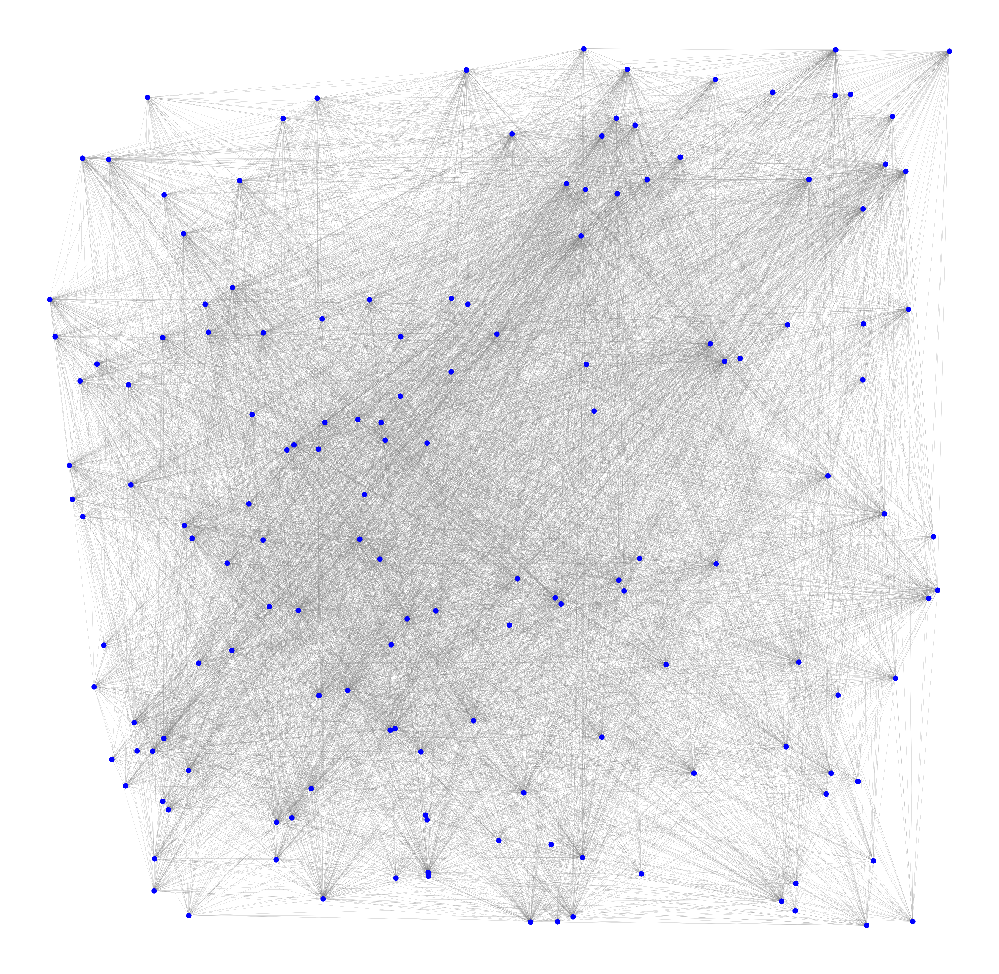

In [15]:
draw_graph_matplotlib(generations, 1, gen1_graph)

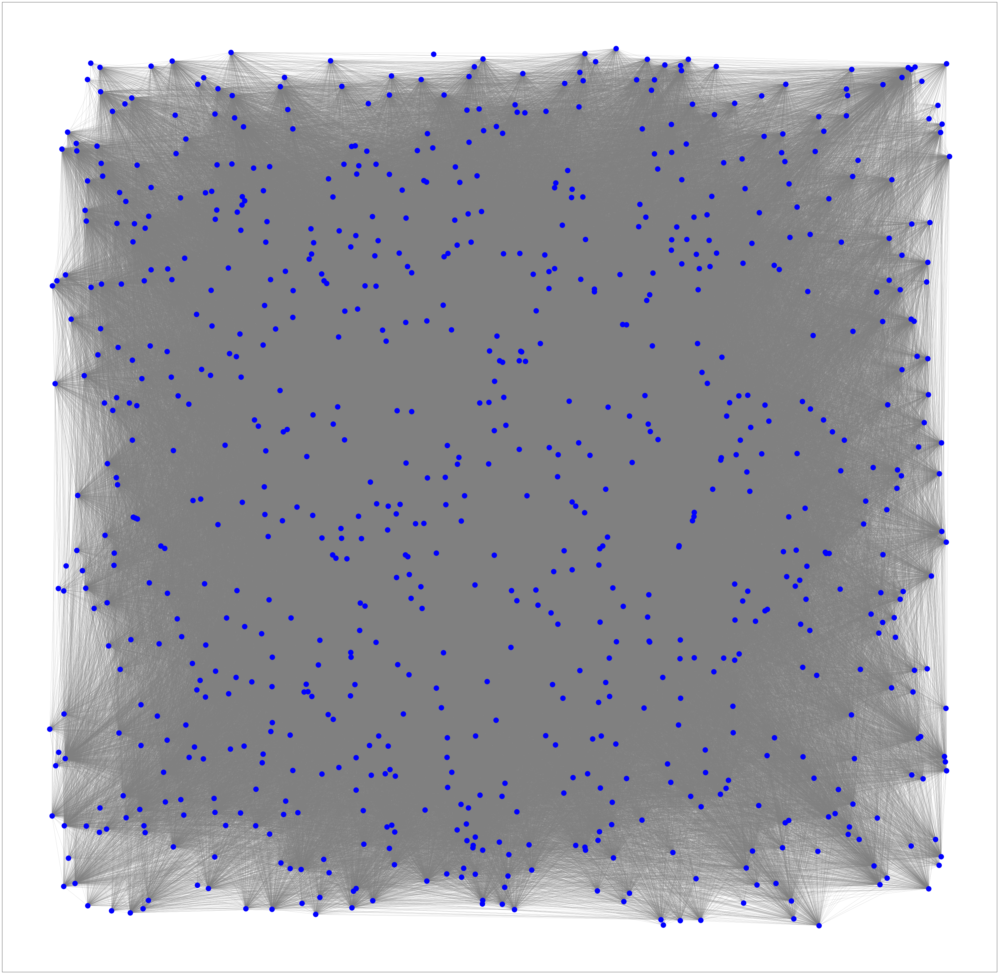

In [16]:
draw_graph_matplotlib(generations, 1, all_season_graph)

## Community detection

In [17]:
from fa2 import ForceAtlas2
from matplotlib import cm
from community import best_partition, modularity

def detect_and_plot_communities(G, forceAtlas=False):
    
    coms = best_partition(nx.Graph(G))
    com_ids = np.array(list(coms.values()))
    print('The modularity of the network:', round(modularity(coms, nx.Graph(G)), 5))
    color_map = []

    for com_id in com_ids:
        color_map.append(cm.rainbow(com_id*(max(com_ids)*4))[:3])
    undir_tw_G = nx.Graph(G)
    
    if ForceAtlas2 == True:
        force_atlas2 = ForceAtlas2(scalingRatio=100)
        random_pos = force_atlas2.forceatlas2_networkx_layout(undir_tw_G, pos=None, iterations=400)
    else:
        random_pos = nx.random_layout(undir_tw_G)

    clear_output(wait=True)
    print(coms)

    plt.figure(figsize=(10, 10), dpi=200)
    nx.draw_networkx_nodes(undir_tw_G, pos=random_pos, node_color = color_map, 
                           node_size = [v for v in dict(G.degree()).values()])

    nx.draw_networkx_edges(undir_tw_G, pos=random_pos, edge_color= 'grey', width = 0.1 )
    
 #   annotate the community id to each node
    for key in random_pos:
        if G.degree(key) == 0:
            continue
        com_id = coms[key]
        x, y = random_pos[key]
        plt.annotate(str(com_id), (x-0.007, y))

    plt.axis('off')
    
    def print_communities_info():
        print(f"Number of communities: {len(set(com_ids))}")
        for com in set(com_ids):
            print(f"Community label: {com}. Number of elements: {list(com_ids).count(com)} out of {len(list(com_ids))}")
    print_communities_info()

In [18]:
coms = best_partition(nx.Graph(gen1_graph))
com_ids = np.array(list(coms.values()))

In [19]:
pokemons_by_coms = {}
for key in coms:
    com_id = coms[key]
    if com_id not in pokemons_by_coms.keys():
        pokemons_by_coms[com_id] = [key]
    else:
        pokemons_by_coms[com_id].append(key)

{'Bulbasaur': 0, 'Ivysaur': 1, 'Venusaur': 0, 'Charmander': 0, 'Charmeleon': 2, 'Charizard': 0, 'Squirtle': 0, 'Wartortle': 1, 'Blastoise': 0, 'Caterpie': 3, 'Metapod': 3, 'Butterfree': 0, 'Weedle': 1, 'Kakuna': 3, 'Beedrill': 3, 'Pidgey': 3, 'Pidgeotto': 2, 'Pidgeot': 1, 'Rattata': 3, 'Raticate': 3, 'Spearow': 3, 'Fearow': 1, 'Ekans': 0, 'Arbok': 1, 'Pikachu': 4, 'Raichu': 1, 'Sandshrew': 3, 'Sandslash': 0, 'Nidoran♀': 3, 'Nidorina': 3, 'Nidoqueen': 0, 'Nidoran♂': 3, 'Nidorino': 3, 'Nidoking': 1, 'Clefairy': 0, 'Clefable': 0, 'Vulpix': 1, 'Ninetales': 1, 'Jigglypuff': 1, 'Wigglytuff': 1, 'Zubat': 2, 'Golbat': 1, 'Oddish': 3, 'Gloom': 3, 'Vileplume': 1, 'Paras': 3, 'Parasect': 3, 'Venonat': 1, 'Venomoth': 1, 'Diglett': 1, 'Dugtrio': 2, 'Meowth': 0, 'Persian': 3, 'Psyduck': 2, 'Golduck': 2, 'Mankey': 3, 'Primeape': 3, 'Growlithe': 3, 'Arcanine': 1, 'Poliwag': 3, 'Poliwhirl': 1, 'Poliwrath': 1, 'Abra': 0, 'Kadabra': 0, 'Alakazam': 1, 'Machop': 0, 'Machoke': 0, 'Machamp': 1, 'Bellsprout':

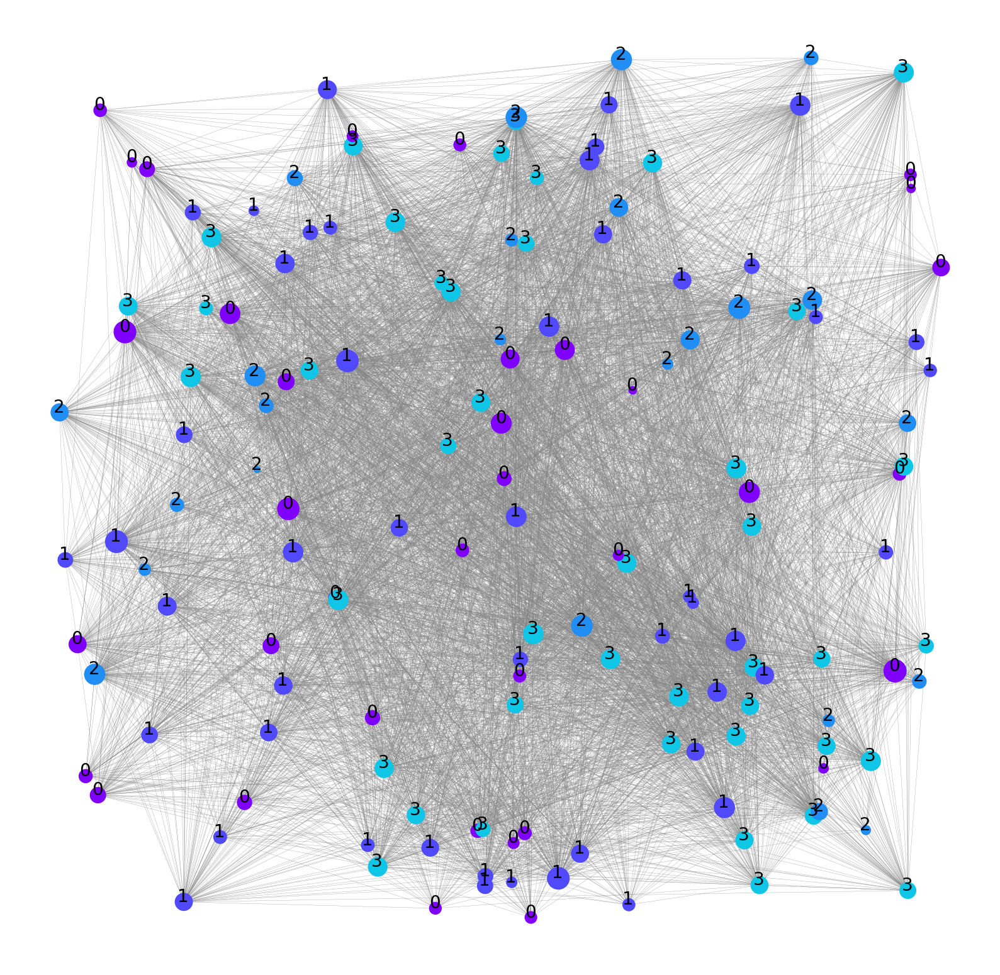

In [20]:
detect_and_plot_communities(gen1_graph, forceAtlas=False)

{'Chikorita': 0, 'Bayleef': 1, 'Meganium': 1, 'Cyndaquil': 1, 'Quilava': 1, 'Typhlosion': 2, 'Totodile': 1, 'Croconaw': 3, 'Feraligatr': 4, 'Sentret': 4, 'Furret': 1, 'Hoothoot': 4, 'Noctowl': 1, 'Ledyba': 4, 'Ledian': 1, 'Spinarak': 1, 'Ariados': 1, 'Crobat': 1, 'Chinchou': 3, 'Lanturn': 5, 'Pichu': 5, 'Cleffa': 0, 'Igglybuff': 1, 'Togepi': 1, 'Togetic': 6, 'Natu': 4, 'Xatu': 1, 'Mareep': 4, 'Flaaffy': 7, 'Ampharos': 4, 'Bellossom': 4, 'Marill': 5, 'Azumarill': 5, 'Sudowoodo': 3, 'Politoed': 3, 'Hoppip': 4, 'Skiploom': 3, 'Jumpluff': 5, 'Aipom': 1, 'Sunkern': 1, 'Sunflora': 4, 'Yanma': 1, 'Wooper': 4, 'Quagsire': 4, 'Espeon': 3, 'Umbreon': 3, 'Murkrow': 1, 'Slowking': 1, 'Misdreavus': 3, 'Unown': 1, 'Wobbuffet': 1, 'Girafarig': 4, 'Pineco': 0, 'Forretress': 1, 'Dunsparce': 1, 'Gligar': 4, 'Steelix': 0, 'Snubbull': 4, 'Granbull': 4, 'Qwilfish': 5, 'Scizor': 4, 'Shuckle': 1, 'Heracross': 0, 'Sneasel': 3, 'Teddiursa': 1, 'Ursaring': 1, 'Slugma': 1, 'Magcargo': 1, 'Swinub': 1, 'Piloswine'

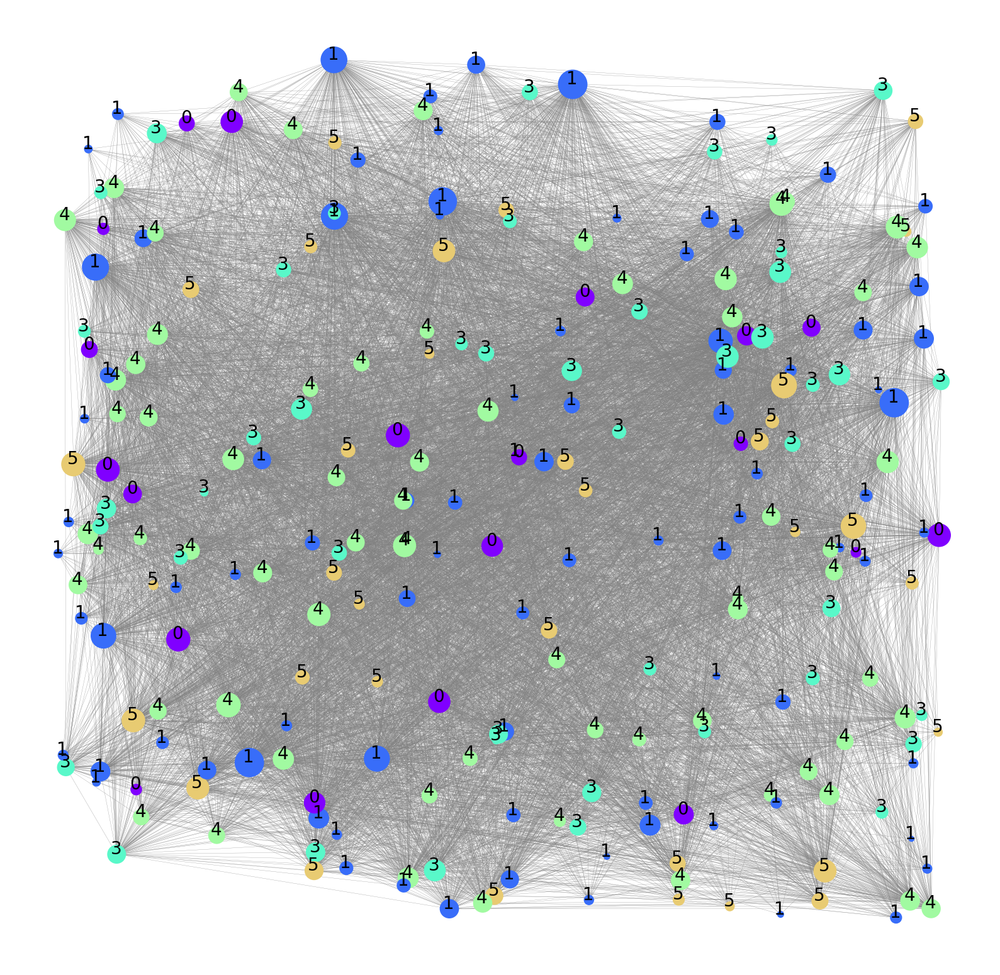

In [21]:
detect_and_plot_communities(gen2_graph)

{'Treecko': 0, 'Grovyle': 0, 'Sceptile': 1, 'Torchic': 0, 'Combusken': 0, 'Blaziken': 2, 'Mudkip': 0, 'Marshtomp': 1, 'Swampert': 3, 'Poochyena': 0, 'Mightyena': 0, 'Zigzagoon': 0, 'Linoone': 0, 'Wurmple': 2, 'Silcoon': 0, 'Beautifly': 0, 'Cascoon': 0, 'Dustox': 0, 'Lotad': 0, 'Lombre': 0, 'Ludicolo': 0, 'Seedot': 0, 'Nuzleaf': 0, 'Shiftry': 1, 'Taillow': 0, 'Swellow': 0, 'Wingull': 0, 'Pelipper': 0, 'Ralts': 2, 'Kirlia': 2, 'Gardevoir': 0, 'Surskit': 4, 'Masquerain': 4, 'Shroomish': 0, 'Breloom': 4, 'Slakoth': 4, 'Vigoroth': 4, 'Slaking': 4, 'Nincada': 0, 'Ninjask': 3, 'Shedinja': 4, 'Whismur': 4, 'Loudred': 0, 'Exploud': 1, 'Makuhita': 4, 'Hariyama': 0, 'Azurill': 0, 'Nosepass': 0, 'Skitty': 0, 'Delcatty': 4, 'Sableye': 0, 'Mawile': 2, 'Aron': 0, 'Lairon': 4, 'Aggron': 3, 'Meditite': 0, 'Medicham': 4, 'Electrike': 0, 'Manectric': 0, 'Plusle': 0, 'Minun': 0, 'Volbeat': 0, 'Illumise': 4, 'Roselia': 4, 'Gulpin': 0, 'Swalot': 4, 'Carvanha': 0, 'Sharpedo': 0, 'Wailmer': 0, 'Wailord': 0, '

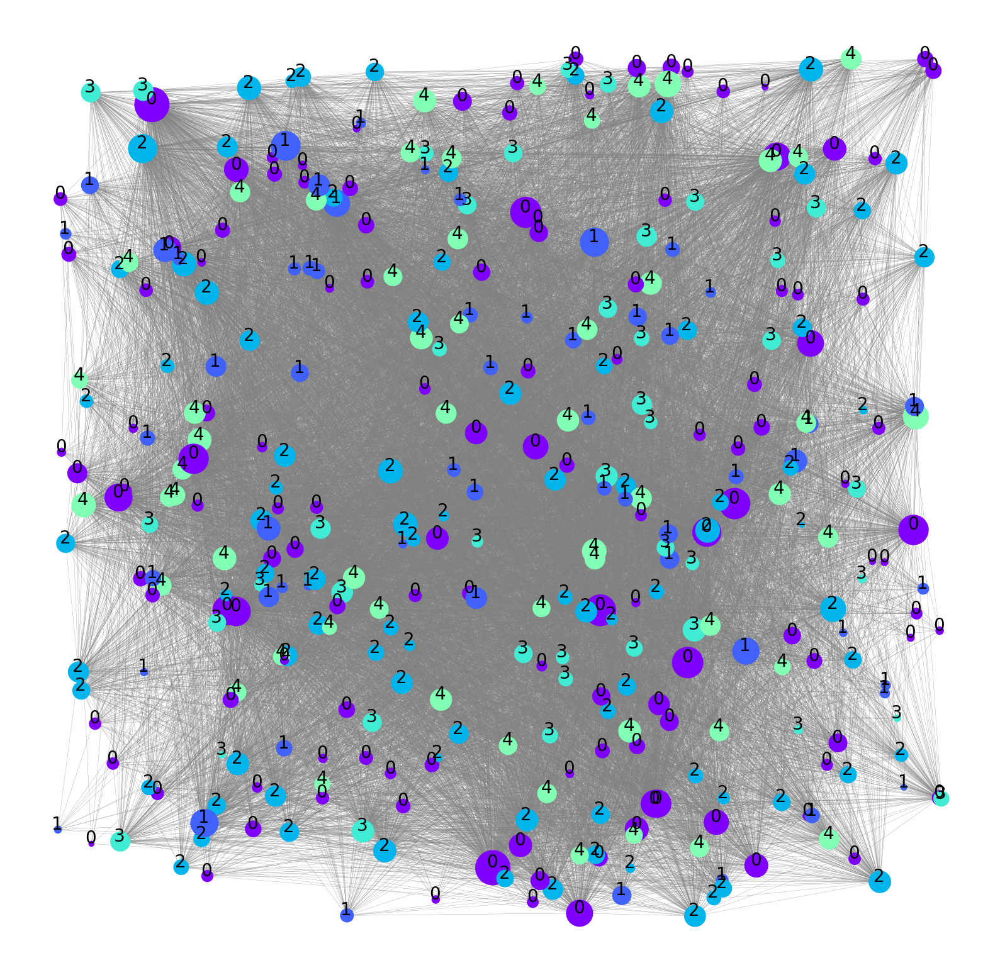

In [22]:
detect_and_plot_communities(gen3_graph)

{'Turtwig': 0, 'Grotle': 1, 'Torterra': 1, 'Chimchar': 0, 'Monferno': 1, 'Infernape': 1, 'Piplup': 0, 'Prinplup': 2, 'Empoleon': 1, 'Starly': 2, 'Staravia': 0, 'Staraptor': 1, 'Bidoof': 2, 'Bibarel': 2, 'Kricketot': 2, 'Kricketune': 3, 'Shinx': 2, 'Luxio': 3, 'Luxray': 4, 'Budew': 2, 'Roserade': 1, 'Cranidos': 2, 'Rampardos': 2, 'Shieldon': 0, 'Bastiodon': 5, 'Burmy': 0, 'Wormadam': 0, 'Mothim': 0, 'Combee': 0, 'Vespiquen': 0, 'Pachirisu': 0, 'Buizel': 0, 'Floatzel': 2, 'Cherubi': 6, 'Cherrim': 3, 'Shellos': 0, 'Gastrodon': 3, 'Ambipom': 0, 'Drifloon': 6, 'Drifblim': 2, 'Buneary': 0, 'Lopunny': 3, 'Mismagius': 2, 'Honchkrow': 1, 'Glameow': 2, 'Purugly': 1, 'Chingling': 0, 'Stunky': 1, 'Skuntank': 1, 'Bronzor': 1, 'Bronzong': 2, 'Bonsly': 2, 'Mime Jr.': 0, 'Happiny': 0, 'Chatot': 0, 'Spiritomb': 5, 'Gible': 3, 'Gabite': 3, 'Garchomp': 2, 'Munchlax': 0, 'Riolu': 6, 'Lucario': 1, 'Hippopotas': 0, 'Hippowdon': 4, 'Skorupi': 0, 'Drapion': 6, 'Croagunk': 0, 'Toxicroak': 1, 'Carnivine': 0, 'F

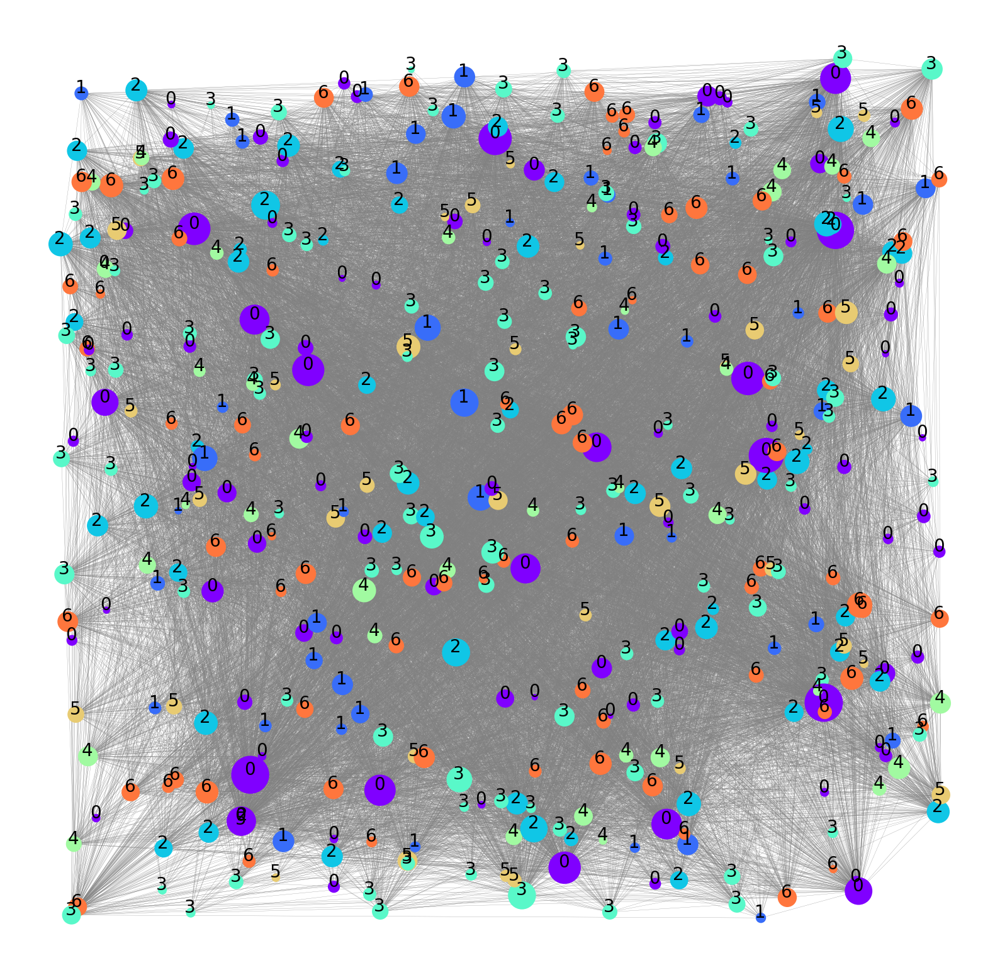

In [23]:
detect_and_plot_communities(gen4_graph)

{'Victini': 0, 'Snivy': 1, 'Servine': 2, 'Serperior': 3, 'Tepig': 1, 'Pignite': 1, 'Emboar': 3, 'Oshawott': 1, 'Dewott': 1, 'Samurott': 4, 'Patrat': 2, 'Watchog': 2, 'Lillipup': 2, 'Herdier': 2, 'Stoutland': 3, 'Purrloin': 4, 'Liepard': 2, 'Pansage': 1, 'Simisage': 1, 'Pansear': 2, 'Simisear': 1, 'Panpour': 2, 'Simipour': 1, 'Munna': 2, 'Musharna': 1, 'Pidove': 2, 'Tranquill': 1, 'Unfezant': 5, 'Blitzle': 2, 'Zebstrika': 3, 'Roggenrola': 1, 'Boldore': 5, 'Gigalith': 6, 'Woobat': 1, 'Swoobat': 6, 'Drilbur': 1, 'Excadrill': 1, 'Audino': 2, 'Timburr': 1, 'Gurdurr': 3, 'Conkeldurr': 1, 'Tympole': 3, 'Palpitoad': 5, 'Seismitoad': 4, 'Throh': 1, 'Sawk': 3, 'Sewaddle': 2, 'Swadloon': 2, 'Leavanny': 5, 'Venipede': 2, 'Whirlipede': 1, 'Scolipede': 2, 'Cottonee': 2, 'Whimsicott': 1, 'Petilil': 4, 'Lilligant': 2, 'Basculin': 2, 'Sandile': 2, 'Krokorok': 1, 'Krookodile': 5, 'Darumaka': 2, 'Darmanitan': 2, 'Maractus': 2, 'Dwebble': 1, 'Crustle': 1, 'Scraggy': 1, 'Scrafty': 1, 'Sigilyph': 1, 'Yamask

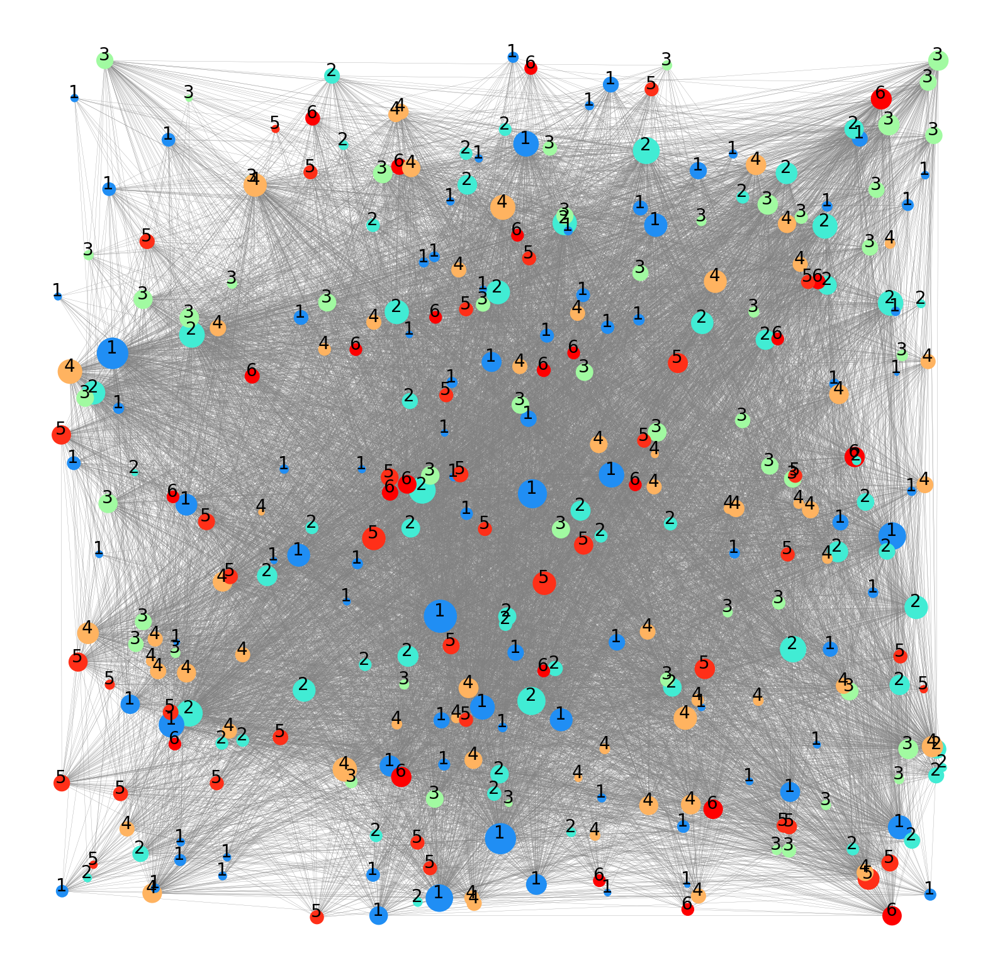

In [24]:
detect_and_plot_communities(gen5_graph)

# 2. Pokemon Routes Graph

In [25]:
import re
import os
import itertools
import networkx as nx
import time
from IPython.display import clear_output
import numpy as np
import csv
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from networkx.algorithms import bipartite

In [26]:
pokemon_dir = "./pokemon_gen1/"
pokemon_names = sorted(os.listdir("pokemon_gen1/"))
pokemon_names.remove("[151]Mew")

In [27]:
all_occurances = {}
location_list = set()
raw_locations = {}

for pokemon in pokemon_names:
    poke_path = pokemon_dir + pokemon
    poke_file = open(poke_path, encoding='utf-8').read()
    pokemon_text = re.findall(r"(?<=Game locations===)(.*)(?=In side games)", poke_file)
    poke_VandA = re.findall(r"(v=)(.*?)\\\\n", str(pokemon_text))
    for x in poke_VandA :
        if pokemon not in raw_locations:
            raw_locations[pokemon] = [x[1]]
        else:
            raw_locations[pokemon].append(x[1])

In [28]:
for pokemon, version in raw_locations.items():
    places = set()
    for x in version:
        v1 = re.findall(r".+?(?=\|)", str(x))
        if len(v1) > 0:
            v1 = v1[0]
        else:
            v1 = re.findall(r".+?(?=\})", str(x))
            v1 = v1[0]
        if v1 == "Yellow":
            x = x.replace("[", "{")
            x = x.replace("]", "}")
            loc = re.findall(r"(?<=\{\{)(.*?)(?=\}\})", str(x))
            for place in loc:
                if "List" in place:
                    place = "Special Event"
                elif place[:2] == 'p|':
                    continue
                elif "Surf" in place or "surf" in place:
                    place = "Surfing"
                if place[:3] == 'rtn':
                    place = place.replace('rtn', 'rt', 1)
                places.add(place)
                location_list.add(place)
    if places == set():
        pokemon_names.remove(pokemon)
    if ('Evolution|Evolve') in places:
        pokemon_names.remove(pokemon)
        continue
    if "Route" in places:
        places.remove("Route")
    if "Routes" in places:
        places.remove("Routes")
    all_occurances[pokemon] = places

In [29]:
location_list.remove("Routes")
location_list.remove("Route")
location_list.remove('Evolution|Evolve')

In [30]:
G = nx.Graph()
G.add_nodes_from(pokemon_names)
G.add_nodes_from(location_list)

In [31]:
for name, locations in all_occurances.items():
    for place in locations:
        G.add_edge(name, place)

In [32]:
names, locations = bipartite.sets(G)

# sub_graphs = nx.connected_component_subgraphs(G)

# for i, sg in enumerate(sub_graphs):
#     print(f"subgraph {i} has {sg.number_of_nodes()} nodes")
#     print ("\tNodes:", sg.nodes(data=True))
#     print ("\tEdges:", sg.edges())

In [33]:
nodes = list(G.nodes())

for node in range(len(nodes)):
    if (re.search(r"rt\|(\d*?)\|Kanto", nodes[node])):
        number = re.findall(r"rt\|(\d*?)\|Kanto", nodes[node])[0]
        nodes[node] = nodes[node].replace(nodes[node], f"Kanto Route {number}")
    elif (nodes[node] == 'Evolution|Evolve'):
        nodes[node] = "Evolution"
    elif (nodes[node] == 'In-game trade#Yellow|Trade'):
        nodes[node] = "Trade for"
    elif ("List" in nodes[node]):
        nodes[node] = "Special Event"
    elif (nodes[node] == 'Fishing#In the games|Super Rod'):
        nodes[node] = "Fishing"
    elif (nodes[node] == 'tt|*|immediately evolves into Machamp, but Pokédex data is entered'):
        nodes[node] = "Immediately evolves"
    elif (nodes[node] == "Diglett\\\\'s Cave"):
        nodes[node] = "Deglett's Cave"
    elif ("|" in nodes[node]):
        nodes[node] = nodes[node].replace("|", " ")       

In [34]:
node_adjacencies = []
color_map = []
for x in G.nodes():
    if x in location_list:
        color_map.append('rgb(0,240,0)')
    else:
        color_map.append('rgb(192, 143, 227)')
for node, adjacencies in enumerate(G.adjacency()):
    node_adjacencies.append(5 + len(adjacencies[1]))

In [35]:
force_atlas2 = ForceAtlas2()
pos=force_atlas2.forceatlas2_networkx_layout(G, pos=None, iterations=1000)
Xn=[pos[k][0] for k in G.nodes()]
Yn=[pos[k][1] for k in G.nodes()]

trace_nodes=dict(type='scatter',
                 x=Xn, 
                 y=Yn,
                 mode='markers',
                 text=nodes,
                 marker=dict(size=node_adjacencies, color=color_map),
                 hoverinfo='text')

Xe=[]
Ye=[]
for e in G.edges():
    Xe.extend([pos[e[0]][0], pos[e[1]][0], None])
    Ye.extend([pos[e[0]][1], pos[e[1]][1], None])
trace_edges=dict(type='scatter',
                 mode='lines',
                 x=Xe,
                 y=Ye,
                 line=dict(width=1, color='rgb(25,25,25)'),
                 hoverinfo='none' 
                )

100%|██████████| 1000/1000 [00:00<00:00, 1374.46it/s]

BarnesHut Approximation  took  0.25  seconds
Repulsion forces  took  0.39  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.04  seconds


In [36]:
axis=dict(showline=False, # hide axis line, grid, ticklabels and  title
          zeroline=False,
          showgrid=False,
          showticklabels=False,
          title='' 
          )
layout=dict(width=600,
            height=600,
            autosize=False,
            showlegend=False,
            xaxis=axis,
            yaxis=axis,
            margin=dict(
            l=40,
            r=40,
            b=85,
            t=100,
            pad=0,
       
    ),
    hovermode='closest',
    plot_bgcolor='#efecea', #set background color            
    )


fig = dict(data=[trace_edges, trace_nodes], layout=layout)

In [37]:
from plotly.offline import iplot

iplot(fig)

In [38]:
from community import best_partition, modularity

In [39]:
coms = best_partition(nx.Graph(G))
com_ids = np.array(list(coms.values()))
print('The modularity of the network:', round(modularity(coms, nx.Graph(G)), 5))

The modularity of the network: 0.51017


In [40]:
for color in range(len(color_map)):
    color_map[color] = color_map[color][4:-1].split(",")
    color_map[color][0] = int(color_map[color][0]) / 255
    color_map[color][1] = int(color_map[color][1]) / 255
    color_map[color][2] = int(color_map[color][2]) / 255
    color_map[color] = tuple(color_map[color])

100%|██████████| 400/400 [00:00<00:00, 1813.21it/s]

BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.14  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.01  seconds



/home/gustaw/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



(-168.66107509022402,
 140.35370932012293,
 -233.78592155855154,
 182.84495001863218)

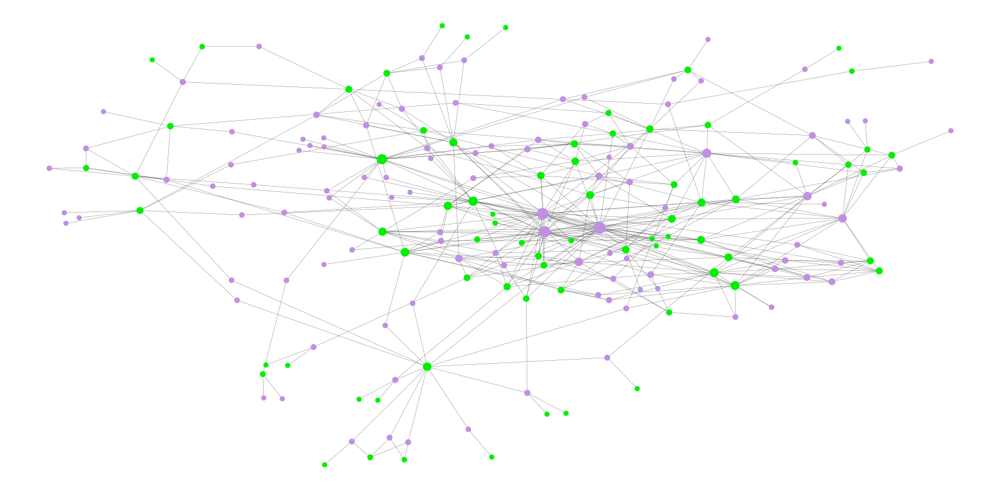

In [41]:
newG = nx.Graph(G)
force_atlas2 = ForceAtlas2()
positions = force_atlas2.forceatlas2_networkx_layout(newG, pos=None, iterations=400)

plt.figure(figsize=(30,15))
nx.draw_networkx_nodes(newG, pos=positions, node_color = color_map, 
                       node_size = [10*v for v in node_adjacencies])

nx.draw_networkx_edges(newG, pos=positions, width = 0.25 )

plt.axis('off')

# 3. Sentiment analysis

## 3.1 Pokemon preprocessing

Preparing text for sentiment analysis, creating a data frame of pokemon.

In [42]:
# Load the necessary packages
import json, re, networkx as nx, numpy as np, os, sys, nltk, pandas as pd
from tqdm import tqdm_notebook

### Data Analysis - Cleansing of the html data

In [43]:
# Functions to use for cleaning the pokemon data. Used in context with the regex.
def my_replace(s):
    if len(s[0].split("|")) == 1:
        return s[0][2:-2]
    else:
        return s[0].split("|")[-1][:-2]

def my_replace2(s):
    if len(s[0].split("|")) == 1:
        return s[0].split("[[")[1][:-2]
    else:
        return s[0].split("|")[-1][:-2]

In [44]:
poke_biology = {}

# Loop through all the pokemon files
for file in tqdm_notebook(os.listdir("pokemon_files_raw/")):
    path = 'pokemon_files_raw/' + file
    poke_file = open(path, encoding='utf-8').read()  # Load the file 
    poke_name = file.split(']')[-1]                  # Save the name of the pokemon

    # Get the biology text 
    try:
        # this finds the content in the biology. Section after biology tends to be "in the anime"
        bio_text = re.findall("(?<=Biology==)(.*)(?===In the anime)", poke_file)[0] 
        
        # this finds the links and replaces the links with the hyperlink text. Also removes newline charcs and random \
        bio_text = re.sub("{{[\wé|\s\( \)',-]+}}", my_replace , bio_text).replace("\\n", " ").replace("\\", "")
        
        # Does the same as before but with the square brackets instead
        bio_text = re.sub("\[\[[\w\s|é'\\.#:!,-]+\]\]", my_replace2, bio_text)
        
        # Some pokemon contains html object <ref>. These are removed
        bio_text = re.sub("(<ref>)(.*)<\/ref>", "", bio_text)
        poke_biology[poke_name] = bio_text
    except:
        print(poke_name)
        continue
    

Type



### Preparing the data - Tokenization

In [45]:
# Tokenize the biology description and exclude stopwords
from nltk.corpus import stopwords
poke_biology_tokens = {}
poke_biology_tokens_stemmed = {}
porter = nltk.PorterStemmer()

# Define the stopword set. Include punctuation and other symbols
stop_wrds = set(stopwords.words('english'))
stop_wrds.update(['.',',','!','?',':',';'])

for pokemon in tqdm_notebook(poke_biology):
    bio_text = poke_biology[pokemon]
    poke_tokens = nltk.word_tokenize(bio_text)
    poke_biology_tokens[pokemon] = [word.lower() for word in poke_tokens if word.lower() not in stop_wrds 
                   and len(re.findall('\A[a-zA-Z]+', word)) > 0]
    
    # This creates a stemmed version of the biology text tokens
    poke_biology_tokens_stemmed[pokemon] = [porter.stem(word.lower()) for word in poke_tokens  
                                            if word.lower() not in stop_wrds and len(re.findall('\A[a-zA-Z]+', word)) > 0]

### Sentiment analysis of the biology description

In [46]:
import urllib

# Get the LabMT lexicon to use for the sentiment analysis
url = 'https://journals.plos.org/plosone/article/file?id=10.1371/journal.pone.0026752.s001&type=supplementary'
df_sentiment = pd.read_csv(url, skiprows=2, header=None, sep='\t')

# need to set the column names and remove the first row
df_sentiment.columns = df_sentiment.iloc[0]
df_sentiment = df_sentiment.drop(df_sentiment.index[0]).reset_index()
df_sentiment = df_sentiment.drop(['index'], axis=1)
df_sentiment[['happiness_rank', 'happiness_average', 'happiness_standard_deviation']] = \
df_sentiment[['happiness_rank', 'happiness_average', 'happiness_standard_deviation']].apply(pd.to_numeric)
print(df_sentiment.head())

# Define a function to compute the sentiment of a list of tokens
def calculate_token_list_sentiment(tokens):
    no_words_labeled = len(tokens)
    happines_sum = 0
    
    word_count = 0
    for word in tokens:
        if word in list(df_sentiment['word']):
            word_count += 1
            happines_sum += df_sentiment[df_sentiment['word'] == word]['happiness_average'].item()    
    if word_count == 0:
        return -1
    return happines_sum / word_count

0       word  happiness_rank  happiness_average  happiness_standard_deviation  \
0   laughter               1               8.50                        0.9313   
1  happiness               2               8.44                        0.9723   
2       love               3               8.42                        1.1082   
3      happy               4               8.30                        0.9949   
4    laughed               5               8.26                        1.1572   

0 twitter_rank google_rank nyt_rank lyrics_rank  
0         3600          --       --        1728  
1         1853        2458       --        1230  
2           25         317      328          23  
3           65        1372     1313         375  
4         3334        3542       --        2332  


In [47]:
poke_sentiment = {}
poke_sentiment_stemmed = {}
for pokemon in tqdm_notebook(poke_biology_tokens):
    poke_sentiment[pokemon] = calculate_token_list_sentiment(poke_biology_tokens[pokemon])
    poke_sentiment_stemmed[pokemon] = calculate_token_list_sentiment(poke_biology_tokens_stemmed[pokemon])
    

In [48]:
# Loop through all the pokemon files
poke_types = {}
count = 0
for file in tqdm_notebook(os.listdir("pokemon_files_raw/")):
    count += 1
    path = 'pokemon_files_raw/' + file
    poke_file = open(path, encoding='utf-8').read()  # Load the file 
    poke_name = file.split(']')[-1]                  # Save the name of the pokemon

    # Find where the type is written in the html files with regex
    try:
        types = re.findall("{{PokémonPrevNext\/Head\|type=[\w+|=\s]+}}", poke_file)[0]
    except:
        continue
    types = re.findall("type=[\w\|=]+", types)[0]
    types = types.split('=')
    
    # Check if pokemon has 1 or 2 types
    if len(types) == 2:
        poke_type = (types[1])
    elif len(types) == 3:
        types = types[1:]
        poke_type = (types[0].split("|")[0], types[1])
    poke_types[poke_name] = poke_type

### Find the statistics of the pokemons

In [49]:
stats = {'HP': [], 'Attack' : [], 'Defense' : [], 'SpAtk' : [], 'SpDef' : [], 'Speed' : []}
for file in tqdm_notebook(os.listdir("pokemon_files_raw/")):
    path = 'pokemon_files_raw/' + file
    poke_file = open(path, encoding='utf-8').read()  # Load the file 
    poke_name = file.split(']')[-1]                  # Save the name of the pokemon
    
    # Use regex to locate the statistics with positive lookbehinds
    poke_stat = (re.findall("((?<=HP=)[\s\d]+)|((?<=Attack=)[\s\d]+)|((?<=Defense=)[\s\d]+)|((?<=SpAtk=)[\s\d]+)|((?<=SpDef=)[\s\d]+)|((?<=Speed=)[\s\d]+)"
           , poke_file)[:6])
    try:
        stats['HP'].append(int(poke_stat[0][0]))
        stats['Attack'].append(int(poke_stat[1][1]))
        stats['Defense'].append(int(poke_stat[2][2]))
        stats['SpAtk'].append( int(poke_stat[3][3]))
        stats['SpDef'].append(int(poke_stat[4][4]))
        stats['Speed'].append(int(poke_stat[5][5]))
    except:
        print(poke_name)

Type



### Putting it all together


In [50]:
# Create a pandas dataframe to store all the data for easier access to statistics
data = {'Pokémon' : list(poke_biology.keys()), 'Sentiment' : list(poke_sentiment.values()), 
        'Sentiment_stemmed' : list(poke_sentiment_stemmed.values())  ,'Type': list(poke_types.values()) , 
        'HP' : stats['HP'], 'Attack' : stats['Attack'], 'Defense' : stats['Defense'], 'SpAtk' :stats['SpAtk'], 
        'SpDef' : stats['SpDef'], 'Speed' : stats['Speed']}

poke_df = pd.DataFrame(data = data ,columns=['Pokémon','Sentiment','Sentiment_stemmed','Type','HP','Attack','Defense','SpAtk','SpDef','Speed'])

# Define a new column called total stats
Total_stats = poke_df.iloc[:,4:10].sum(axis=1)
poke_df['Total'] = Total_stats
poke_df.head()

,Pokémon,Sentiment,Sentiment_stemmed,Type,HP,Attack,Defense,SpAtk,SpDef,Speed,Total
0,Combusken,5.473673,5.355946,"(Fire, Fighting)",60,85,60,85,60,55,405
1,Oranguru,5.779722,5.813846,"(Normal, Psychic)",90,60,80,90,110,60,490
2,Bronzong,5.721667,5.694138,"(Steel, Psychic)",67,89,116,79,116,33,500
3,Galvantula,5.505917,5.450000,"(Bug, Electric)",70,77,60,97,60,108,472
4,Emboar,5.358132,5.272069,"(Fire, Fighting)",110,123,65,100,65,65,528


In [51]:
# Create a pandas dataframe to store all the data for easier access to statistics
data = {'Pokémon' : list(poke_biology.keys()), 'Sentiment' : list(poke_sentiment.values()), 
        'Sentiment_stemmed' : list(poke_sentiment_stemmed.values())  ,'Type': list(poke_types.values()) , 
        'HP' : stats['HP'], 'Attack' : stats['Attack'], 'Defense' : stats['Defense'], 'SpAtk' :stats['SpAtk'], 
        'SpDef' : stats['SpDef'], 'Speed' : stats['Speed']}

poke_df = pd.DataFrame(data = data ,columns=['Pokémon','Sentiment','Sentiment_stemmed','Type','HP','Attack','Defense','SpAtk','SpDef','Speed'])

# Define a new column called total stats
Total_stats = poke_df.iloc[:,4:10].sum(axis=1)
poke_df['Total'] = Total_stats
poke_df.head()

,Pokémon,Sentiment,Sentiment_stemmed,Type,HP,Attack,Defense,SpAtk,SpDef,Speed,Total
0,Combusken,5.473673,5.355946,"(Fire, Fighting)",60,85,60,85,60,55,405
1,Oranguru,5.779722,5.813846,"(Normal, Psychic)",90,60,80,90,110,60,490
2,Bronzong,5.721667,5.694138,"(Steel, Psychic)",67,89,116,79,116,33,500
3,Galvantula,5.505917,5.450000,"(Bug, Electric)",70,77,60,97,60,108,472
4,Emboar,5.358132,5.272069,"(Fire, Fighting)",110,123,65,100,65,65,528


In [52]:
gen_count = []
for file in os.listdir('pokemon_files_raw/'):
    poke_file = open('pokemon_files_raw/' + file, encoding='utf-8').read()
    try:
        gen = gen_count.append(re.findall('(?<=introduced in \[\[Generation )\w+', poke_file)[0])
        
    except:
        if poke_file == '[772]Type':
            gen_count.append('VII')
        print(file)

poke_df['Generation'] = gen_count
poke_df.head()

[772]Type


,Pokémon,Sentiment,Sentiment_stemmed,Type,HP,Attack,Defense,SpAtk,SpDef,Speed,Total,Generation
0,Combusken,5.473673,5.355946,"(Fire, Fighting)",60,85,60,85,60,55,405,III
1,Oranguru,5.779722,5.813846,"(Normal, Psychic)",90,60,80,90,110,60,490,VII
2,Bronzong,5.721667,5.694138,"(Steel, Psychic)",67,89,116,79,116,33,500,IV
3,Galvantula,5.505917,5.450000,"(Bug, Electric)",70,77,60,97,60,108,472,V
4,Emboar,5.358132,5.272069,"(Fire, Fighting)",110,123,65,100,65,65,528,V


In [53]:
# Find all the legendary pokemons
type_count = []
for file in os.listdir('pokemon_files_raw/'):
    poke_file = open('pokemon_files_raw/' + file, encoding='utf-8').read()
    try:
        # Use a regex to locate whether a pokemon is a mythical or legendary
        poke_type = (re.findall('(Mythical |Legendary )(?=Pokémon\]\] introduced)', poke_file))[0]
        if poke_type.strip() == 'Legendary':                
            type_count.append('Legendary')
        elif poke_type.strip() == 'Mythical':
            type_count.append('Mythical')
        else:
            type_count.append('None')
    except:
        if file == '[772]Type': # This file is corrupt
            continue
        type_count.append('None')

poke_df['Legendary'] = type_count
poke_df.head()

,Pokémon,Sentiment,Sentiment_stemmed,Type,HP,Attack,Defense,SpAtk,SpDef,Speed,Total,Generation,Legendary
0,Combusken,5.473673,5.355946,"(Fire, Fighting)",60,85,60,85,60,55,405,III,None
1,Oranguru,5.779722,5.813846,"(Normal, Psychic)",90,60,80,90,110,60,490,VII,None
2,Bronzong,5.721667,5.694138,"(Steel, Psychic)",67,89,116,79,116,33,500,IV,None
3,Galvantula,5.505917,5.450000,"(Bug, Electric)",70,77,60,97,60,108,472,V,None
4,Emboar,5.358132,5.272069,"(Fire, Fighting)",110,123,65,100,65,65,528,V,None


In [54]:
for idx, typ in tqdm_notebook(enumerate(poke_df.Type)):
    if typ[0] == '(':
        poke_df.Type[idx] = tuple(sorted(eval(poke_df.Type[idx])))


## 3.2  Sentiment Analysis of the differen pokemon types

In [55]:
# Load the necessary packages
import json, re, networkx as nx, numpy as np, os, sys, nltk, matplotlib.pyplot as plt, pandas as pd, wordcloud
from tqdm import tqdm_notebook
from scipy.stats import spearmanr
from os import path
from PIL import Image

In [56]:
# Load the pokemon dataframe

poke_df = pd.read_csv('pokemon_data.csv')
poke_df.head()

,Pokémon,Sentiment,Sentiment_stemmed,Type,HP,Attack,Defense,SpAtk,SpDef,Speed,Total,Generation,Legendary,Tokens,Tokens_stemmed
0,Voltorb,5.878889,5.902800,Electric,40,30,50,55,55,100,330,I,None,"['voltorb', 'spherical', 'pokémon', 'resembles...","['voltorb', 'spheric', 'pokémon', 'resembl', '..."
1,Electrode,5.716471,5.585263,Electric,60,50,70,80,80,140,480,I,None,"['electrode', 'round', 'pokémon', 'resembling'...","['electrod', 'round', 'pokémon', 'resembl', 'r..."
2,Exeggcute,5.632933,5.577097,"('Grass', 'Psychic')",60,40,80,60,45,40,325,I,None,"['exeggcute', 'pokémon', 'resembling', 'six', ...","['exeggcut', 'pokémon', 'resembl', 'six', 'lig..."
3,Exeggutor,5.623797,5.670000,"('Grass', 'Psychic')",95,95,85,125,65,55,520,I,None,"['exeggutor', 'tall', 'bipedal', 'pokémon', 'r...","['exeggutor', 'tall', 'biped', 'pokémon', 'res..."
4,Cubone,5.261880,5.271667,Ground,50,50,95,40,50,35,320,I,None,"['cubone', 'small', 'bipedal', 'pokémon', 'lig...","['cubon', 'small', 'biped', 'pokémon', 'light'..."


In [57]:
# Get all the found pokemon types
poke_types = poke_df.Type.unique()
corr_dict = {}
corr_dict_stemmed = {}
for poke_type in tqdm_notebook(poke_types):
    # First get the pokemons with the specific type
    pokemons_by_type = poke_df[poke_df['Type'] == poke_type]
    
    # Get their sentiment values and their total stats
    pokemons_by_type_sentiment_stemmed = pokemons_by_type['Sentiment_stemmed']
    pokemons_by_type_sentiment = pokemons_by_type['Sentiment']
    pokemons_by_type_total = pokemons_by_type['Total']
    
    # Check correlation between biology text sentiment and total stats and store it
    corr_coef_stemmed = spearmanr(pokemons_by_type_sentiment_stemmed, pokemons_by_type_total)[0]
    corr_coef = spearmanr(pokemons_by_type_sentiment, pokemons_by_type_total)[0]
    
    # Only check for correlation if more than 5 pokemons of this type exists
    if len(pokemons_by_type) >= 5:
        corr_dict[poke_type] = corr_coef
        corr_dict_stemmed[poke_type] = corr_coef_stemmed
        
    
    

/home/gustaw/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning:

invalid value encountered in true_divide

/home/gustaw/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning:

invalid value encountered in true_divide

/home/gustaw/anaconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning:

invalid value encountered in greater

/home/gustaw/anaconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning:

invalid value encountered in less

/home/gustaw/anaconda3/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1892: RuntimeWarning:

invalid value encountered in less_equal



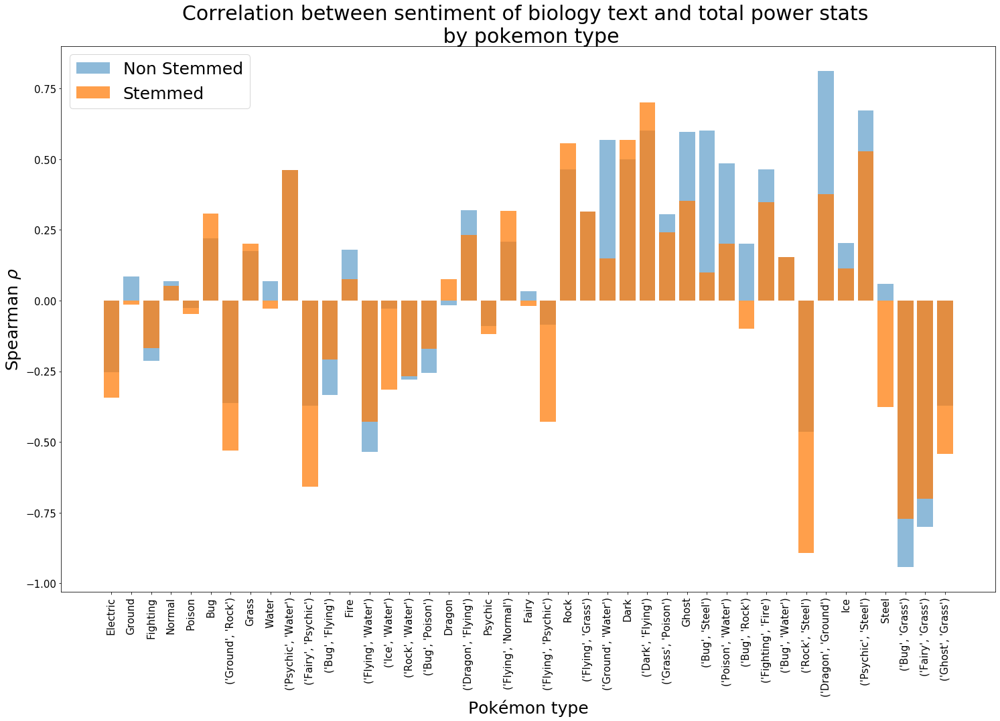

In [58]:
# Plot the results for both the stemmed and non stemmed versions
plt.figure(figsize=(25,15))
plt.bar((corr_dict.keys()), (corr_dict.values()), label = 'Non Stemmed', alpha = .5)
plt.bar((corr_dict_stemmed.keys()), (corr_dict_stemmed.values()), label = 'Stemmed', alpha = .75)
plt.xticks(rotation='vertical', size=15)
plt.yticks(size=15)
plt.title('Correlation between sentiment of biology text and total power stats \n by pokemon type', fontsize = 30)
plt.ylabel(r'Spearman $\rho$', fontsize = 25)
plt.xlabel('Pokémon type', fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

In [59]:
poke_df.iloc[:10]['Sentiment'].apply(round, ndigits=3)

0    5.879
1    5.716
2    5.633
3    5.624
4    5.262
5    5.286
6    5.620
7    5.456
8    5.600
9    5.481
Name: Sentiment, dtype: float64

In [60]:
# Used to generate the word clouds for each type
single_types = sorted(poke_df.Type.unique())[119:]
single_types

['Bug',
 'Dark',
 'Dragon',
 'Electric',
 'Fairy',
 'Fighting',
 'Fire',
 'Flying',
 'Ghost',
 'Grass',
 'Ground',
 'Ice',
 'Normal',
 'Poison',
 'Psychic',
 'Rock',
 'Steel',
 'Water']

In [61]:
type_tokens = {}
type_corpus = {}
# Loop through all the single types
for types in single_types:
    type_tokens[types] = ""
    # Get all the tokens for that specific type
    tokens = poke_df.Tokens[poke_df.Type == types]    
    type_corpus[types] = []
    # Join all the tokens in a large string and store it in a dictionary indexed by type as key
    for token in tokens:
        type_corpus[types].extend(eval(token))
        type_tokens[types] += " ".join(eval(token))
        type_tokens[types] += " "

In [62]:
def augmented_Frequency(FreqDist):
    aug_tf = []
    tf = []
    total_words = len(FreqDist)
    max_freq = FreqDist.most_common(1)[0][1]
    total_freqs = sum(FreqDist.values())
    # This way we will start with the most frequent appearing word and adjusting for it 
    for word, freq in FreqDist.most_common(total_words):
        aug_tf_val = 0.5 + 0.5 * (freq/max_freq)
        aug_tf.append((word, aug_tf_val, freq))
        tf.append((word, freq/total_freqs, freq))
    
    return aug_tf, tf

In [63]:
from nltk import FreqDist
tf_types = {}
tf_idf_types = {}

number_corp = len(single_types)
for types in single_types:
    tf_types[types] = augmented_Frequency(FreqDist(type_corpus[types]))

for types in tqdm_notebook(single_types):
    aug_tf = tf_types[types][0]
    tf_idf_types[types] = []
    for word, tf, freq in aug_tf:
        word_count_corpus = 0
        for single_type in single_types:
            tmp_corpus = tf_types[single_type][0]
            for word_other, _, _ in tmp_corpus:
                if word == word_other:
                    word_count_corpus += 1
                    break
        idf_val = np.log(number_corp/word_count_corpus)
        tf_idf_types[types].append((word, tf, idf_val, tf*idf_val, freq))
        

#for freq_dist in freq_dists:
#    current_corpus = freq_dists[freq_dist]
    

In [64]:
tf_idf_strings = {}
for key in tf_idf_types:
    tf_idf_strings[key] = ""
    for word, _, _, tf_idf, _ in tf_idf_types[key]:
        tf_idf_strings[key] += " ".join([int(np.ceil(tf_idf)) * f'{word} '])

In [65]:
wordclouds = {}
for types in tqdm_notebook(type_tokens):
    wordclouds[types] = wordcloud.WordCloud(stopwords=['pokémon','two','three','like']
                        , collocations=False, background_color='white', width = 800, height = 500).generate(tf_idf_strings[types])